# Read Data

In [2]:
import pandas as pd

In [3]:
sentences = pd.read_csv('data_lda.csv',sep="&",names=["data"])

In [4]:
sentences.head(30)

,data
0,#السورية للمخابز تتحدّث عن #آلية جديدة لبيع #ا...
1,#النقل خلال الاجتماع السنوي #لغرفة الملاحة الب...
2,#فرّح أهلك : خدمة في #مصر تساعد السوريين على ت...
3,#قسد تطالب بتعاون دولي لمحاكمة أسرى داعـش :
4,#نيويورك تايمز نقلا عن مسؤول #أمريكي: إسرائيل ...
5,# # # # ...
6,أريد العودة و إصلاح أخطائي إيميلي كونيغ متطرفة...
7,أساءت للأردن ! تفاصيل جديدة متعلقة بالمعتقلة ا...
8,ألعاب زمان الأتاري مين كان شاطر فيه 😁 #وفا
9,ألغت الكثير من شركات النقل رحلاتها في مختلف مر...


# Build BOW

In [6]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_df=0.1, min_df=5)
dtm = cv.fit_transform(sentences['data'])

In [7]:
len(cv.get_feature_names())

14556

In [8]:
import random
for i in range(10):
    random_word_id = random.randint(0,14556)
    print(cv.get_feature_names()[random_word_id])

يستعد
للعلم
نصف
ڜپگة
تعم
للحياة
صيني
الدخان
وعند
صدر


# lda model

In [9]:
from sklearn.decomposition import LatentDirichletAllocation
LDA = LatentDirichletAllocation(n_components=10,random_state=42)
LDA.fit(dtm)

LatentDirichletAllocation(random_state=42)

In [10]:
len(LDA.components_)

10

In [11]:
result=LDA.transform(dtm)

# Reduce dimension for plotting
    -dimensionality reduction usng tsne model

In [12]:
from sklearn.manifold import TSNE
import numpy as np
result_tsne=TSNE().fit_transform(result)

In [13]:
tsne_df = pd.DataFrame(result_tsne, columns=['x', 'y'])

In [14]:
from sklearn.cluster import MiniBatchKMeans

In [15]:
cls = MiniBatchKMeans(n_clusters=10, random_state=1000)
cl=cls.fit_predict(result)

In [16]:
tsne_df['cluster']=cl

In [17]:
tsne_df['cluster_as_string']=tsne_df['cluster'].apply(str)

In [18]:
import seaborn as sns 

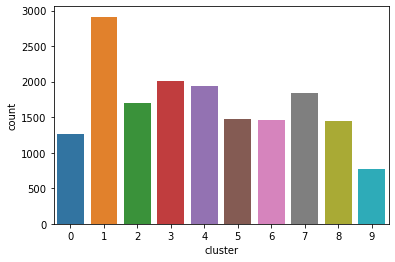

In [19]:
sns.countplot(x='cluster',data=tsne_df)

In [20]:
tsne_df['Topic'] = result.argmax(axis=1)

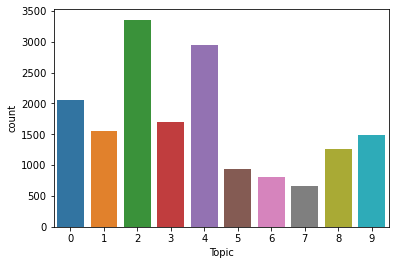

In [21]:
sns.countplot(x='Topic',data=tsne_df)

In [22]:
tsne_df['words']=sentences['data']

In [23]:
tsne_df['Topic']=tsne_df['Topic'].apply(str)

In [24]:
# plot based topics from lda 

In [25]:
import bokeh.plotting as bp
from  bokeh.palettes import d3
from bokeh.models import mappers as bmo
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, BoxSelectTool

output_notebook()
plot_tfidf = bp.figure(plot_width=1000, plot_height=1000, title="A map of word vectors",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

Loading BokehJS ...

In [26]:
palette = d3['Category10'][len(tsne_df['Topic'].unique())]
color_map = bmo.CategoricalColorMapper(factors=tsne_df['Topic'].unique(),
                                   palette=palette)
plot_tfidf.scatter(x='x', y='y', source=tsne_df,color={'field': 'Topic','transform': color_map},size=15)
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"count": "@cluster_as_string","post":"@words","cluster":"@cluster","Topic":"@Topic"}
show(plot_tfidf)

In [ ]:
# plot based cluster

In [30]:
import bokeh.plotting as bp
from  bokeh.palettes import d3
from bokeh.models import mappers as bmo
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, BoxSelectTool

output_notebook()
plot_tfidf = bp.figure(plot_width=1000, plot_height=1000, title="A map of word vectors",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)
palette = d3['Category10'][len(tsne_df['cluster'].unique())]
color_map = bmo.CategoricalColorMapper(factors=tsne_df['cluster_as_string'].unique(),
                                   palette=palette)
plot_tfidf.scatter(x='x', y='y', source=tsne_df,color={'field': 'cluster_as_string','transform': color_map})
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"count": "@cluster_as_string","post":"@words","cluster":"@cluster_as_string"}
show(plot_tfidf)

Loading BokehJS ...

In [ ]:
single_topic = LDA.components_[2]
single_topic.argsort()

In [ ]:
single_topic.argsort()[-10:]

In [ ]:
for index in single_topic.argsort()[-40:]:
    print(cv.get_feature_names()[index])

In [ ]:
for index,topic in enumerate(LDA.components_):
    print(f'THE TOP 15 WORDS FOR TOPIC #{index}')
    print([cv.get_feature_names()[i] for i in topic.argsort()[-15:]])
    print('\n')

In [ ]:
topic_results = LDA.transform(dtm)

In [ ]:
topic_results.shape

In [ ]:
topic_results[0].round(2)

In [ ]:
topic_results.argmax(axis=1)

In [ ]:
npr['Topic'] = topic_results.argmax(axis=1)
npr.head(10)

In [ ]:
npr["Topic"].value_counts()

In [ ]:
import seaborn as sns 

In [ ]:
sns.countplot(x="Topic",data=npr)

In [ ]:
npr[npr['Topic']==4].to_csv("14.csv",index=False) 